In [62]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FFMpegWriter
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib as mpl
mpl.rcParams['animation.ffmpeg_path'] = '/opt/homebrew/bin/ffmpeg' 

In [63]:
# params
L = 2*np.pi          # length of domain
N = 256              # number of grid points
x = np.linspace(0, L, N, endpoint=False)
v = 1.0              # advection param
D = 0              # diffusivity param

#Initial COnditions
x0 = L/2
sigma0 = 0.1
u0 = np.exp(-(x - x0)**2 / (2*sigma0**2))

In [64]:
def analytical_solution_periodic2(x, t, x0, sigma0, v, D, L):

    sigma_t = np.sqrt(sigma0**2 + 2 * D * t)
    x_center = (x0 + v * t) % L

    # Get theshortest wrapped distance cos of periodic domain
    dx = (x - x_center + L/2) % L - L/2

    u = (sigma0 / sigma_t) * np.exp(-0.5 * (dx / sigma_t)**2)

    return u


In [65]:
# FFT Fourier modes
k = np.fft.fftfreq(N, d=L / N) * 2 * np.pi  # wave numbers

# Initial conditinn in Fourier Space
u0_hat = np.fft.fft(u0)

In [66]:
def get_solutions_at_time(t_query, x, u0_hat, k, x0, sigma0, v, D, L):
    # Numerical solution (spectral))
    phase = np.remainder((-v * k * t_query), 2*np.pi)
    evolution_factor = np.exp(1j * phase) * np.exp(-D * (k**2) * t_query)

    #evolution_factor = np.exp((-1j * v * k - D * k**2) * t_query)
    u_hat_t = u0_hat * evolution_factor
    u_t_num = np.fft.ifft(u_hat_t).real

    # Analytical solution
    u_t_exact = analytical_solution_periodic2(x, t_query, x0, sigma0, v, D, L)

    return u_t_num, u_t_exact

$L_2$ Error Plot

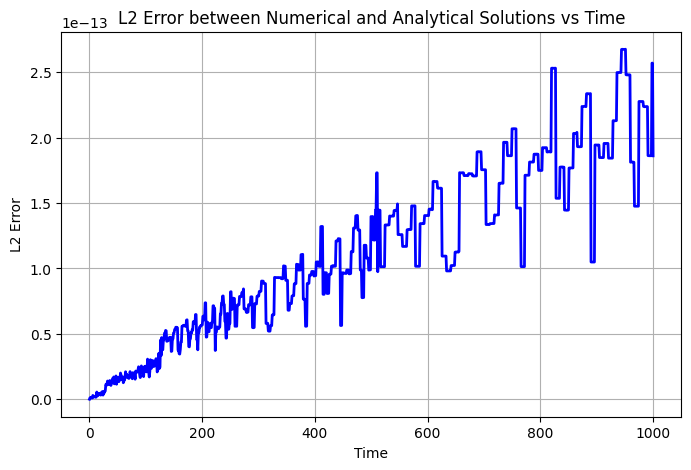

In [67]:
times = np.linspace(0, 1000, 1000)  
errors = []

for t in times:
    #u_t_num, u_t_exact = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L, M=8)
    u_t_num, u_t_exact = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L)

    # Compute the L2 error
    error = u_t_num - u_t_exact
    L2_error = np.sqrt(np.sum(error**2) * (L / N))
    errors.append(L2_error)

plt.figure(figsize=(8,5))
plt.plot(times, errors, 'b-', lw=2)

plt.xlabel("Time")
plt.ylabel("L2 Error")
plt.title("L2 Error between Numerical and Analytical Solutions vs Time")

plt.grid(True)
plt.show()


$L_2$ Error with initial condition using the same fourier subspace as the spectral method  

0.0


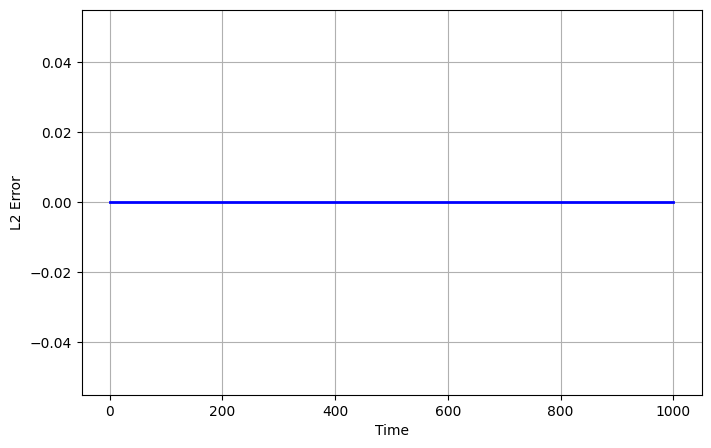

In [68]:
def truncated_analytic(t, u0_hat, k, v, D):

    # exact evolution in the SAME Fourier subspace as numerics
    phase = np.remainder(-v * k * t, 2*np.pi)
    return np.fft.ifft(u0_hat * np.exp(1j*phase) * np.exp(-D*k**2*t)).real
dx = L / N
times = np.linspace(0, 1000, 1000)
errors = []

for t in times:
    u_num, _ = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L)
    u_ref = truncated_analytic(t, u0_hat, k, v, D)
    err = u_num - u_ref
    L2 = np.sqrt(np.sum(err**2) * dx)
    errors.append(L2)

print(errors[500])
plt.figure(figsize=(8,5))
plt.plot(times, errors, 'b-', lw=2)

plt.xlabel("Time")
plt.ylabel("L2 Error")

plt.grid(True)
plt.show()


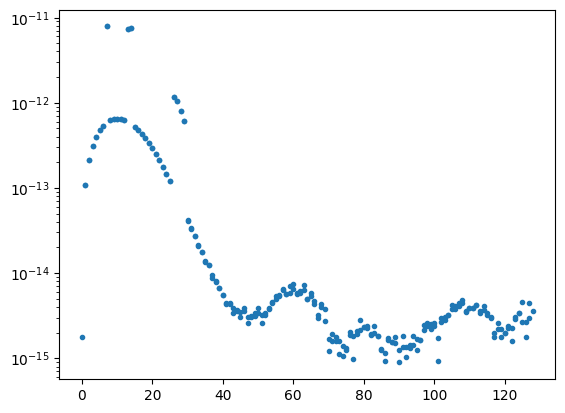

In [ ]:
# Compute error in Fourier space tp see if the error seems cyclic
t = 1000
u_t_num, u_t_exact = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L)
uh_true = np.fft.fft(u_t_exact)
uh_num  = np.fft.fft(u_t_num)

# Compare truncated vs full coefficients
err_modes = np.abs(uh_true - uh_num)
plt.semilogy(np.abs(k), err_modes, '.')

In [70]:
# Time parameters for animation
t_start = 0
t_end = 25
num_frames = 200
times = np.linspace(t_start, t_end, num_frames)

# Set up plot
fig, ax = plt.subplots(figsize=(10,6))
line_exact, = ax.plot([], [], 'k-', lw=2, label='Analytical')
line_num, = ax.plot([], [], 'r--', lw=2, label='Numerical (Spectral)')
line_error, = ax.plot([], [], 'b-', lw=1, label='Error 1e14*|Num - Analytic|')
ax.set_xlim(0, L)
ax.set_ylim(-0.1, 1.2)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.set_title('Advection-Diffusion: Solution evolving in time')
ax.grid(True)
ax.legend()

def init():
    t = times[0]
    evolution_factor = np.exp((-1j * v * k - D * k**2) * t)
    u_hat_t = u0_hat * evolution_factor
    u_t_num = np.fft.ifft(u_hat_t).real
    #u_t_exact = analytical_solution_periodic(x, t, x0, sigma0, v, D, L, M=10)
    u_t_exact = analytical_solution_periodic2(x, t, x0, sigma0, v, D, L)

    line_exact.set_data(x, u_t_exact)
    line_num.set_data(x, u_t_num)
    line_error.set_data(x, 1e14*(u_t_num - u_t_exact))
    return line_exact, line_num, line_error


def update(frame):
    t = times[frame]
    
    # numeirical and analytical solutions
    u_t_num, u_t_exact = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L)

    # Update our plots
    line_exact.set_data(x, u_t_exact)
    line_num.set_data(x, u_t_num)
    line_error.set_data(x, 1e14*np.abs(u_t_num - u_t_exact))

    ax.set_title(f"Advection-Diffusion at t = {t:.2f}")
    return line_exact, line_num, line_error

anim = FuncAnimation(fig, update, frames=num_frames, init_func=init, blit=True, interval=50)

# Set up the ffmpeg writer 
writer = FFMpegWriter(fps=30, extra_args=['-vcodec', 'libx264'])

# Save animation with dpi specified here
anim.save('animation.mp4', writer=writer, dpi=150)

# Display inline in Jupyter
#HTML('<video controls src="animation.mp4" width="700"></video>')
plt.close(fig)  
HTML(anim.to_jshtml())


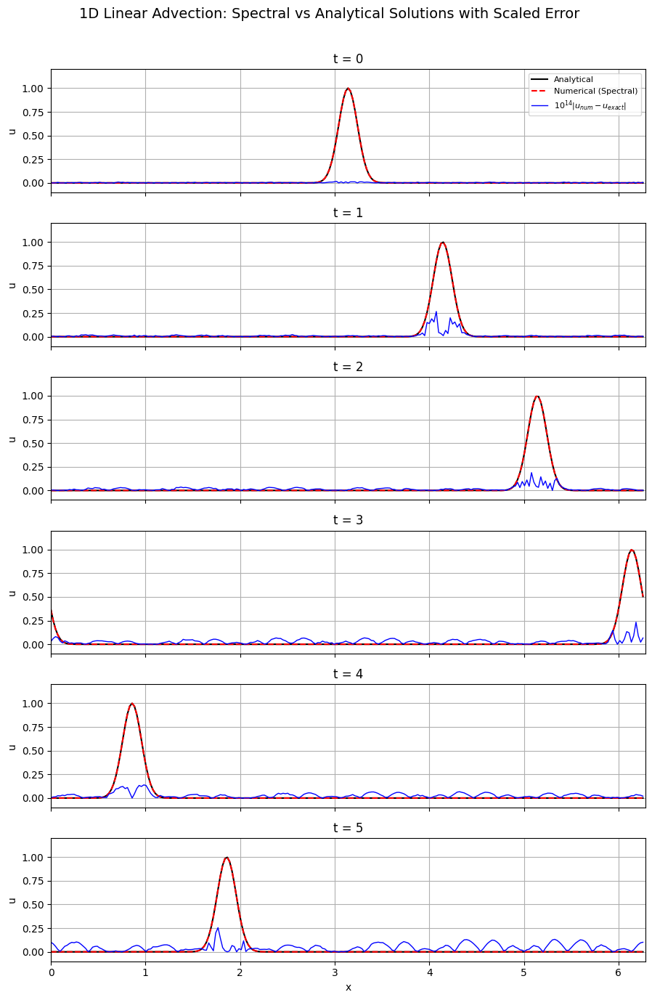

In [71]:
t_samples = np.arange(0, 6, 1)  # t = 0, 1, 2, 3, 4, 5

u_num_list, u_exact_list, error_list = [], [], []
for t in t_samples:

    u_t_num, u_t_exact = get_solutions_at_time(t, x, u0_hat, k, x0, sigma0, v, D, L)

    u_num_list.append(u_t_num)
    u_exact_list.append(u_t_exact)
    error_list.append(1e14 * np.abs(u_t_num - u_t_exact))


fig, axes = plt.subplots(len(t_samples), 1, figsize=(9, 14), sharex=True)

for i, t in enumerate(t_samples):
    ax = axes[i]
    ax.plot(x, u_exact_list[i], 'k-', lw=1.5, label='Analytical')
    ax.plot(x, u_num_list[i], 'r--', lw=1.5, label='Numerical (Spectral)')
    ax.plot(x, error_list[i], 'b-', lw=1, label=r'$10^{14}|u_{num} - u_{exact}|$')
    ax.set_xlim(0, L)
    ax.set_ylim(-0.1, 1.2)
    ax.set_ylabel('u')
    ax.grid(True)
    ax.set_title(f't = {t:.0f}')
    if i == 0:
        ax.legend(loc='upper right', fontsize=8)

axes[-1].set_xlabel('x')
fig.suptitle('1D Linear Advection: Spectral vs Analytical Solutions with Scaled Error', fontsize=14)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

# Upwind Scheme

In [72]:
# params
L = 2*np.pi          # length of domain
N = 256              # number of grid points
x = np.linspace(0, L, N, endpoint=False)
v = 1.0              # advection param
D = 0              # diffusivity param

dx = L/N

#Initial COnditions  
x0 = L/2
sigma0 = 0.1
u0 = analytical_solution_periodic2(x, 0.0, x0, sigma0, v, D, L)
u_initial = u0.copy()

In [73]:
# Time parameters for animation
t_start = 0
t_end = 25
num_frames = 200
# times = np.linspace(t_start, t_end, num_frames)

dt = 0.4 * dx / v
lambda_ = v * dt / dx
steps_per_frame = max(1, int((t_end - t_start) / num_frames / dt))
total_frames = num_frames + 1  # include frame 0

def frame_time(frame):
    return frame * steps_per_frame * dt


# Set up plot
fig, ax = plt.subplots(figsize=(10,6))
line_exact, = ax.plot([], [], 'k-', lw=2, label='Analytical')
line_num, = ax.plot([], [], 'r--', lw=2, label='Numerical (Upwind Scheme)')
# line_error, = ax.plot([], [], 'b-', lw=1, label='Error 1e14*|Num - Analytic|')
ax.set_xlim(0, L)
ax.set_ylim(-0.1, 1.2)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.set_title('Advection-Diffusion: Solution evolving in time')
ax.grid(True)
ax.legend()


def init():
    #t = times[0]
    # t = frame_time(0)

    line_exact.set_data(x, analytical_solution_periodic2(x, t, x0, sigma0, v, D, L))
    line_num.set_data(x, u_initial)


    return line_exact, line_num

u_thing = u0.copy()
def update(frame):

    # Upwind scheme update
    global u_thing
    if frame > 0:
        for _ in range(steps_per_frame):
            u_thing = u_thing - lambda_ * (u_thing - np.roll(u_thing, 1))

    # Update our plots
    t = frame_time(frame)
    line_exact.set_data(x, analytical_solution_periodic2(x, t, x0, sigma0, v, D, L))
    line_num.set_data(x, u_thing)
    #line_error.set_data(x, 1e14*np.abs(u_t_num - u_t_exact))

    ax.set_title(f"Advection-Diffusion at t = {t:.2f}")
    return line_exact, line_num

anim = FuncAnimation(fig, update, frames=total_frames, init_func=init, blit=True, interval=50)


plt.close(fig)  
HTML(anim.to_jshtml())


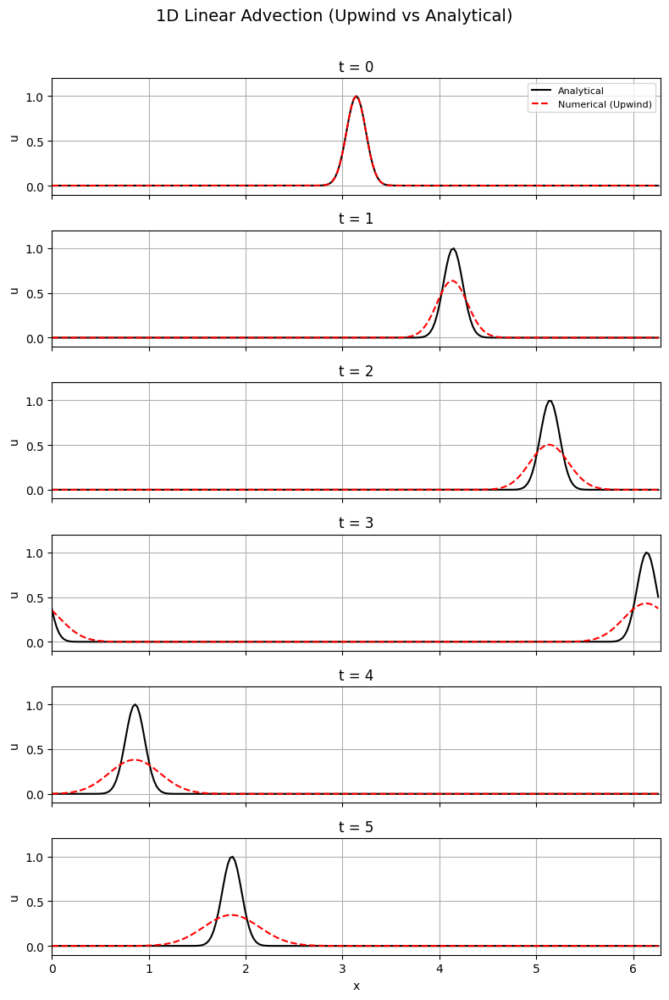

In [74]:
u_num = u_initial.copy()
u_store = [u_initial.copy()] 

t_end = 5.0
t_samples = np.arange(0, t_end + 1, 1)
steps_per_sample = [int(t / dt) for t in t_samples]

current_step = 0
for target_step in steps_per_sample[1:]:
    while current_step < target_step:
        u_num = u_num - lambda_ * (u_num - np.roll(u_num, 1))
        current_step += 1
    u_store.append(u_num.copy())


fig, axes = plt.subplots(len(t_samples), 1, figsize=(8, 12), sharex=True)

for i, t in enumerate(t_samples):
    ax = axes[i]
    ax.plot(x, analytical_solution_periodic2(x, t, x0, sigma0, v, D, L), 'k-', lw=1.5, label='Analytical')
    ax.plot(x, u_store[i], 'r--', lw=1.5, label='Numerical (Upwind)')
    
    ax.set_title(f't = {t:.0f}')
    ax.set_ylabel('u')
    ax.set_xlim(0, L)
    ax.set_ylim(-0.1, 1.2)
    ax.grid(True)
    
    if i == 0:
        ax.legend(loc='upper right', fontsize=8)

axes[-1].set_xlabel('x')
fig.suptitle('1D Linear Advection (Upwind vs Analytical)', fontsize=14)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

Acknowledgements:
AI was used to tidy up some plots